In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import seaborn as sns

from sklearn.cluster import KMeans,AgglomerativeClustering
from sklearn.metrics import silhouette_samples,silhouette_score

from scipy.cluster.hierarchy import cophenet,dendrogram,linkage,distance
from sklearn.metrics.pairwise import euclidean_distances
from scipy.stats import zscore

from sklearn.decomposition import PCA
from yellowbrick.cluster import silhouette_visualizer
from sklearn.preprocessing import PowerTransformer

from warnings import filterwarnings
filterwarnings(action='ignore')

In [2]:
df = pd.read_csv('online_shoppers_intention.csv')

In [3]:
df.head()

,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
0,0,0.0,0,0.0,1,0.000000,0.20,0.20,0.0,0.0,Feb,1,1,1,1,Returning_Visitor,False,False
1,0,0.0,0,0.0,2,64.000000,0.00,0.10,0.0,0.0,Feb,2,2,1,2,Returning_Visitor,False,False
2,0,0.0,0,0.0,1,0.000000,0.20,0.20,0.0,0.0,Feb,4,1,9,3,Returning_Visitor,False,False
3,0,0.0,0,0.0,2,2.666667,0.05,0.14,0.0,0.0,Feb,3,2,2,4,Returning_Visitor,False,False
4,0,0.0,0,0.0,10,627.500000,0.02,0.05,0.0,0.0,Feb,3,3,1,4,Returning_Visitor,True,False


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12330 entries, 0 to 12329
Data columns (total 18 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Administrative           12330 non-null  int64  
 1   Administrative_Duration  12330 non-null  float64
 2   Informational            12330 non-null  int64  
 3   Informational_Duration   12330 non-null  float64
 4   ProductRelated           12330 non-null  int64  
 5   ProductRelated_Duration  12330 non-null  float64
 6   BounceRates              12330 non-null  float64
 7   ExitRates                12330 non-null  float64
 8   PageValues               12330 non-null  float64
 9   SpecialDay               12330 non-null  float64
 10  Month                    12330 non-null  object 
 11  OperatingSystems         12330 non-null  int64  
 12  Browser                  12330 non-null  int64  
 13  Region                   12330 non-null  int64  
 14  TrafficType           

In [5]:
df.isnull().sum().sum()

0

In [6]:
df_info = pd.DataFrame(zip(df.dtypes,df.nunique()),
                       index=df.dtypes.index).reset_index().rename(columns={"index": 'Feature',
                                                                    0:"datatype",
                                                                    1:"unique_values"})
df_info = df_info.sort_values(by=['unique_values'],ascending=1)
cluster_features = df_info[df_info['unique_values'] > 300]['Feature'].values

In [7]:
visualize_1 = df_info[df_info['unique_values'] < 300].iloc[:6]['Feature'].values.tolist()
visualize_2 = df_info[df_info['unique_values'] < 300].iloc[6:10]['Feature'].values.tolist()
visualize_3 = df_info[df_info['unique_values'] < 300].iloc[10:]['Feature'].values.tolist()

In [8]:
df_info[df_info['unique_values'] < 300]

,Feature,datatype,unique_values
17,Revenue,bool,2
16,Weekend,bool,2
15,VisitorType,object,3
9,SpecialDay,float64,6
11,OperatingSystems,int64,8
13,Region,int64,9
10,Month,object,10
12,Browser,int64,13
2,Informational,int64,17
14,TrafficType,int64,20


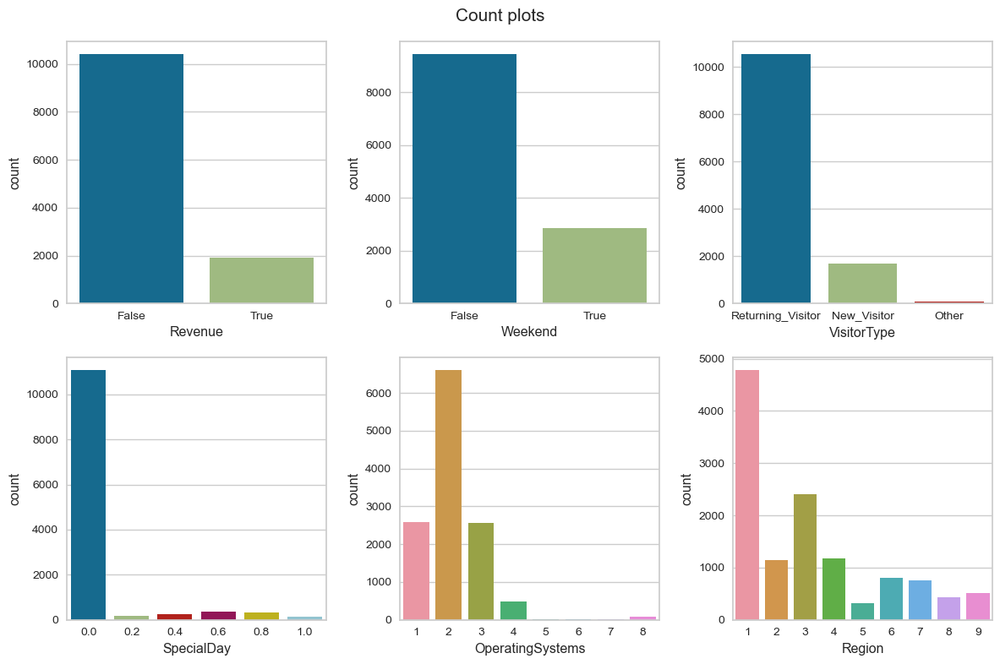

In [9]:
fig, ax = plt.subplots(2,3,figsize=(12,8))
fig.suptitle("Count plots",fontsize=15)
for feature,subplot in zip(visualize_1,ax.flatten()):
    sns.countplot(df[feature],ax=subplot)
    subplot.set_xlabel(subplot.get_xlabel(),fontsize=11.5)
    subplot.set_ylabel(subplot.get_ylabel(),fontsize=11.5)
plt.tight_layout()
plt.show()

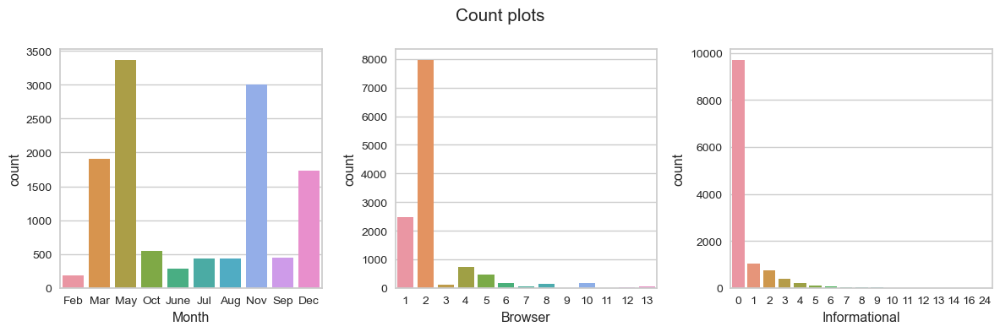

In [10]:
fig, ax = plt.subplots(1,3,figsize=(12,4))
fig.suptitle("Count plots",fontsize=15)
for feature,subplot in zip(visualize_2,ax.flatten()):
    sns.countplot(df[feature],ax=subplot)
    subplot.set_xlabel(subplot.get_xlabel(),fontsize=11.5)
    subplot.set_ylabel(subplot.get_ylabel(),fontsize=11.5)
plt.tight_layout()
plt.show()

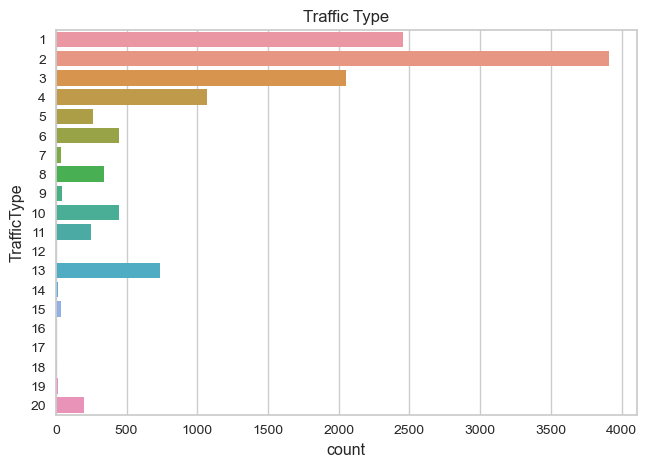

In [11]:
fig, ax = plt.subplots(figsize=(7.5,5))
sns.countplot(y=df['TrafficType'],ax=ax)
ax.set_xlabel(ax.get_xlabel(),fontsize=11.5)
ax.set_ylabel(ax.get_ylabel(),fontsize=11.5)
ax.set_title("Traffic Type")
plt.show()

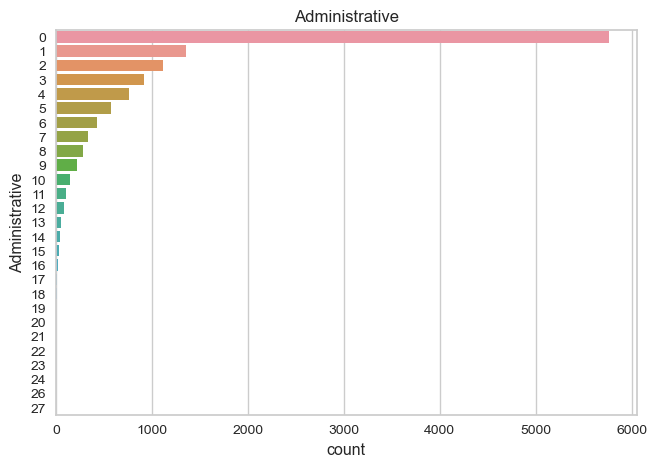

In [12]:
fig, ax = plt.subplots(figsize=(7.5,5))
sns.countplot(y=df[visualize_3[0]],ax=ax)
ax.set_xlabel(ax.get_xlabel(),fontsize=11.5)
ax.set_ylabel(ax.get_ylabel(),fontsize=11.5)
ax.set_title("Administrative")
plt.show()

In [13]:
df.nunique().sort_values(ascending=False)

ProductRelated_Duration    9551
ExitRates                  4777
Administrative_Duration    3335
PageValues                 2704
BounceRates                1872
Informational_Duration     1258
ProductRelated              311
Administrative               27
TrafficType                  20
Informational                17
Browser                      13
Month                        10
Region                        9
OperatingSystems              8
SpecialDay                    6
VisitorType                   3
Weekend                       2
Revenue                       2
dtype: int64

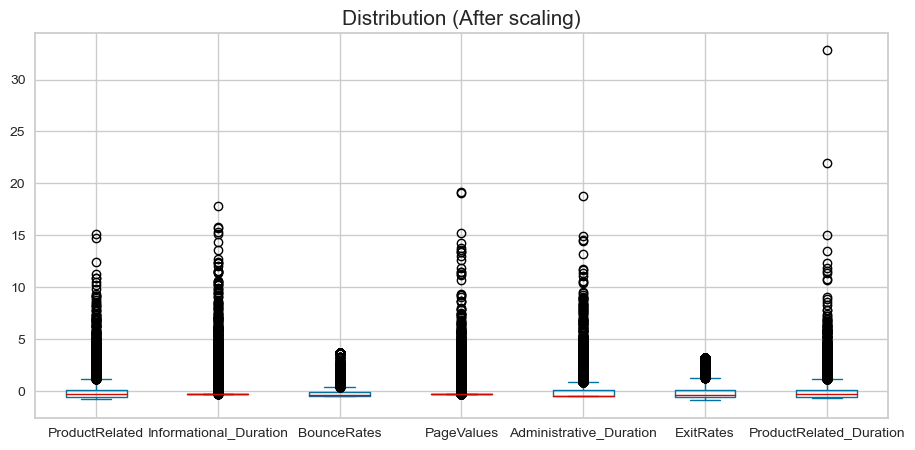

In [14]:
df[cluster_features].apply(zscore).plot(kind='box',figsize=(11,5))
plt.title("Distribution (After scaling)",fontsize=15)
plt.show()

In [15]:
cluster_features

array(['ProductRelated', 'Informational_Duration', 'BounceRates',
       'PageValues', 'Administrative_Duration', 'ExitRates',
       'ProductRelated_Duration'], dtype=object)

In [16]:
df[cluster_features].describe(percentiles=np.linspace(0,1,11))

,ProductRelated,Informational_Duration,BounceRates,PageValues,Administrative_Duration,ExitRates,ProductRelated_Duration
count,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000,12330.000000
mean,31.731468,34.472398,0.022191,5.889258,80.818611,0.043073,1194.746220
std,44.475503,140.749294,0.048488,18.568437,176.779107,0.048597,1913.669288
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
0%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
10%,3.000000,0.000000,0.000000,0.000000,0.000000,0.007449,36.000000
20%,6.000000,0.000000,0.000000,0.000000,0.000000,0.012071,129.000000
30%,9.000000,0.000000,0.000000,0.000000,0.000000,0.016216,246.980000
40%,13.000000,0.000000,0.000000,0.000000,0.000000,0.020513,402.117216
50%,18.000000,0.000000,0.003112,0.000000,7.500000,0.025156,598.936905


In [17]:
## because of outliers, we will consider only 95% of our data

In [18]:
df_95 = df[~(df[cluster_features] > df[cluster_features].quantile(0.95)).any(axis=1)]
df_cluster_data = df_95.copy()
df_95 = df_95[cluster_features]

In [19]:
df_95.describe(percentiles=np.linspace(0,1,11))

,ProductRelated,Informational_Duration,BounceRates,PageValues,Administrative_Duration,ExitRates,ProductRelated_Duration
count,10132.000000,10132.000000,10132.000000,10132.000000,10132.000000,10132.000000,10132.000000
mean,21.696111,7.384299,0.025690,2.148892,43.344243,0.048182,764.915290
std,21.330045,26.062415,0.052652,6.535659,71.424320,0.051813,849.126288
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
0%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
10%,2.000000,0.000000,0.000000,0.000000,0.000000,0.008333,21.000000
20%,5.000000,0.000000,0.000000,0.000000,0.000000,0.013333,95.500000
30%,8.000000,0.000000,0.000000,0.000000,0.000000,0.018182,187.060000
40%,11.000000,0.000000,0.000000,0.000000,0.000000,0.023150,304.850000
50%,15.000000,0.000000,0.003279,0.000000,0.000000,0.028770,459.375000


In [20]:
df[cluster_features].columns

Index(['ProductRelated', 'Informational_Duration', 'BounceRates', 'PageValues',
       'Administrative_Duration', 'ExitRates', 'ProductRelated_Duration'],
      dtype='object')

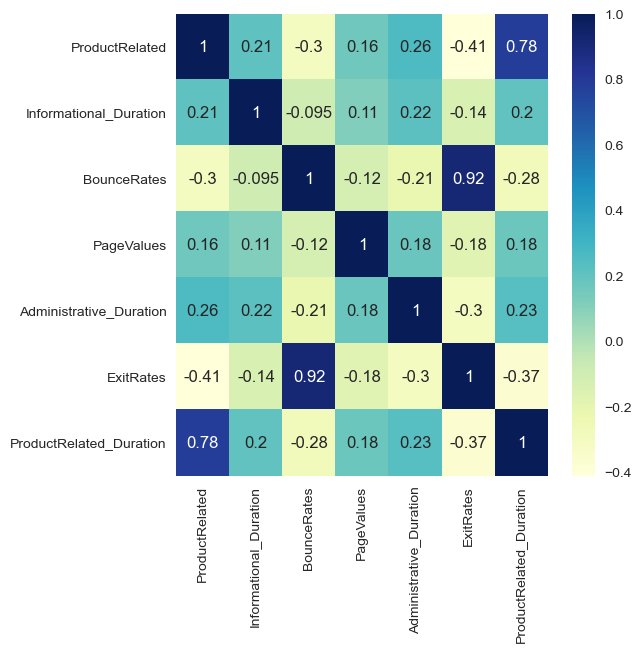

In [21]:
plt.figure(figsize=(6,6))
sns.heatmap(df_95.corr(),annot=True,cmap='YlGnBu')
plt.show()

In [22]:
visualize_1

['Revenue',
 'Weekend',
 'VisitorType',
 'SpecialDay',
 'OperatingSystems',
 'Region']

In [22]:
visualize_2

['Month', 'Browser', 'Informational', 'TrafficType']

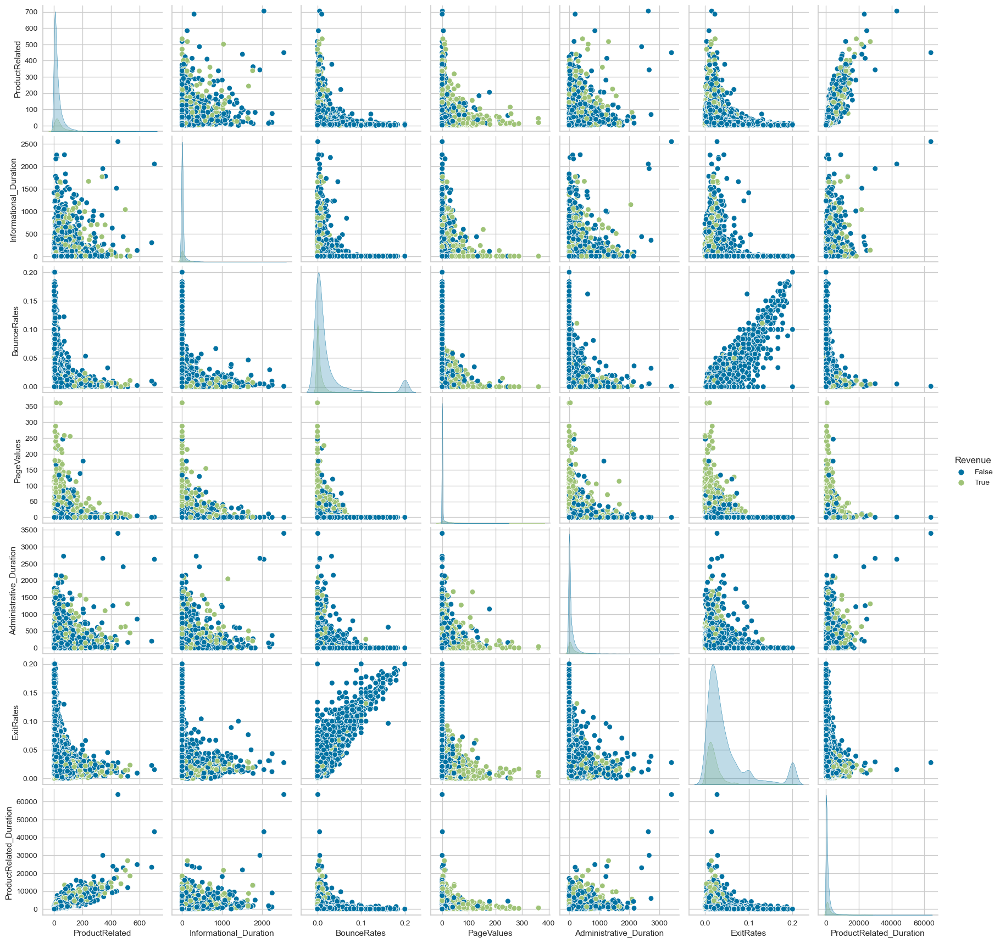

In [598]:
sns.pairplot(data=df,x_vars=cluster_features,y_vars=cluster_features,hue='Revenue')
plt.show()

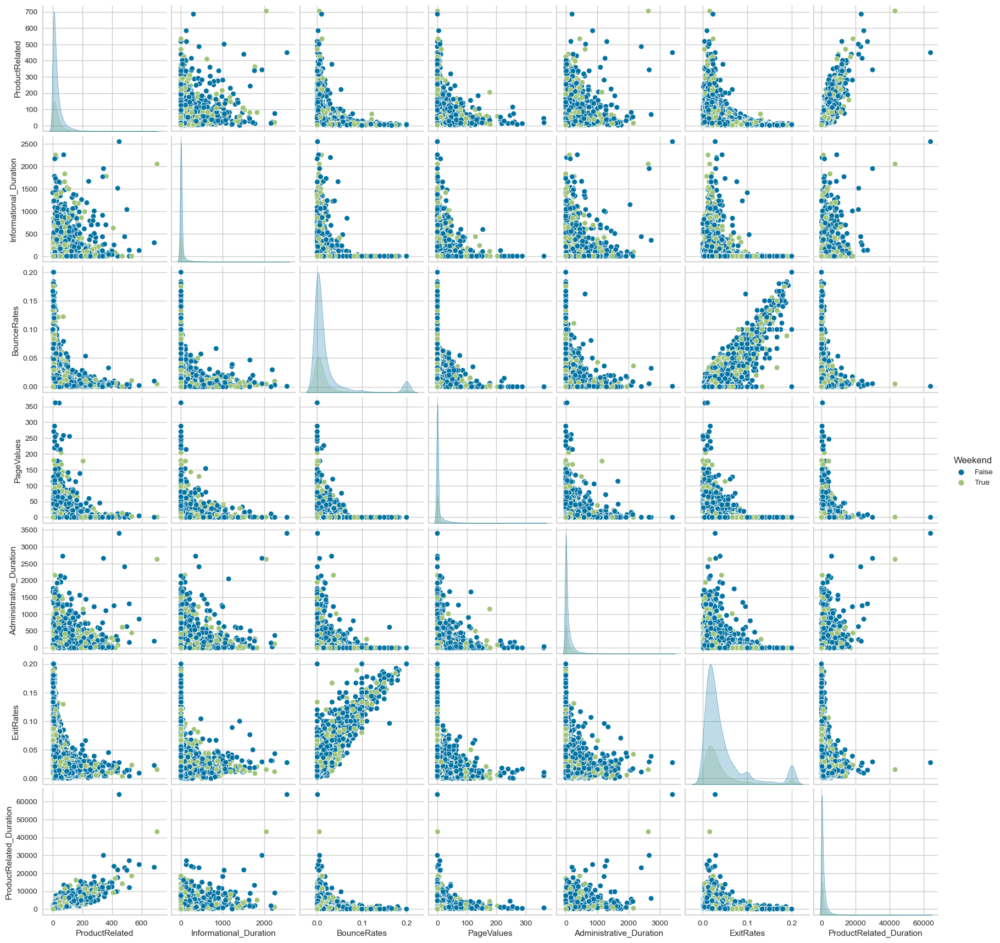

In [605]:
sns.pairplot(data=df,x_vars=cluster_features,y_vars=cluster_features,hue='Weekend')
plt.show()

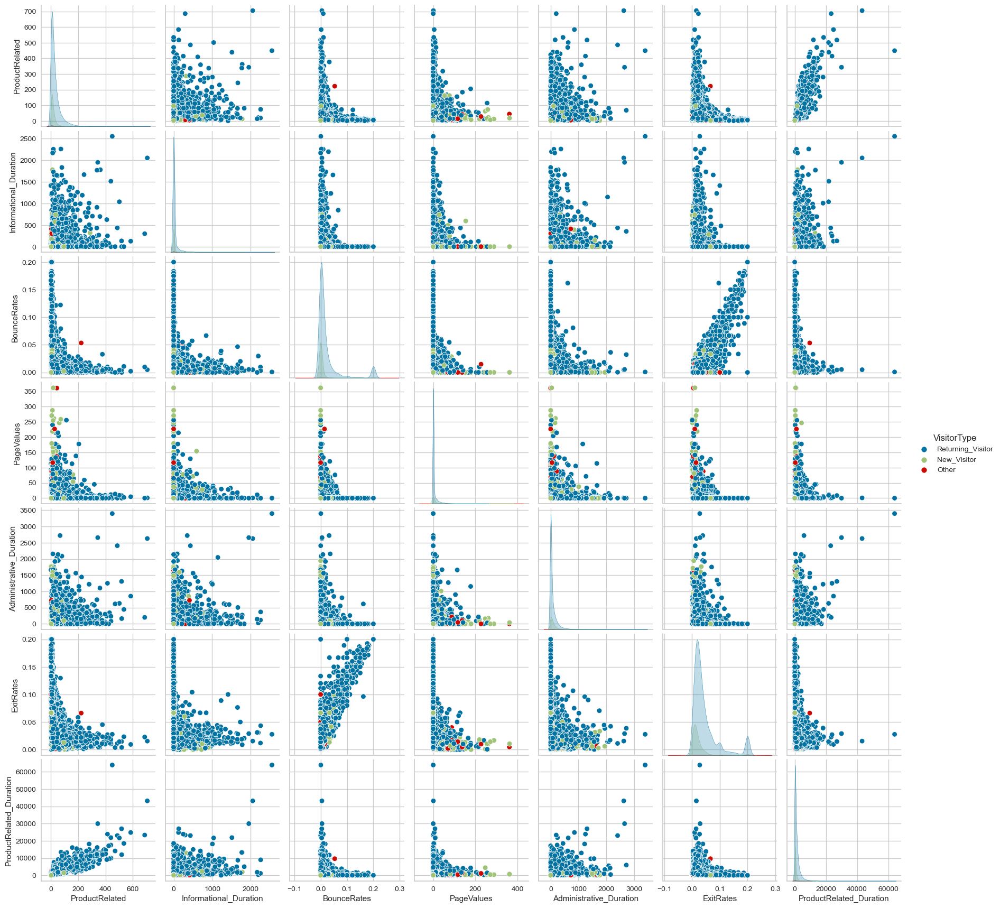

In [600]:
sns.pairplot(data=df,x_vars=cluster_features,y_vars=cluster_features,hue='VisitorType')
plt.show()

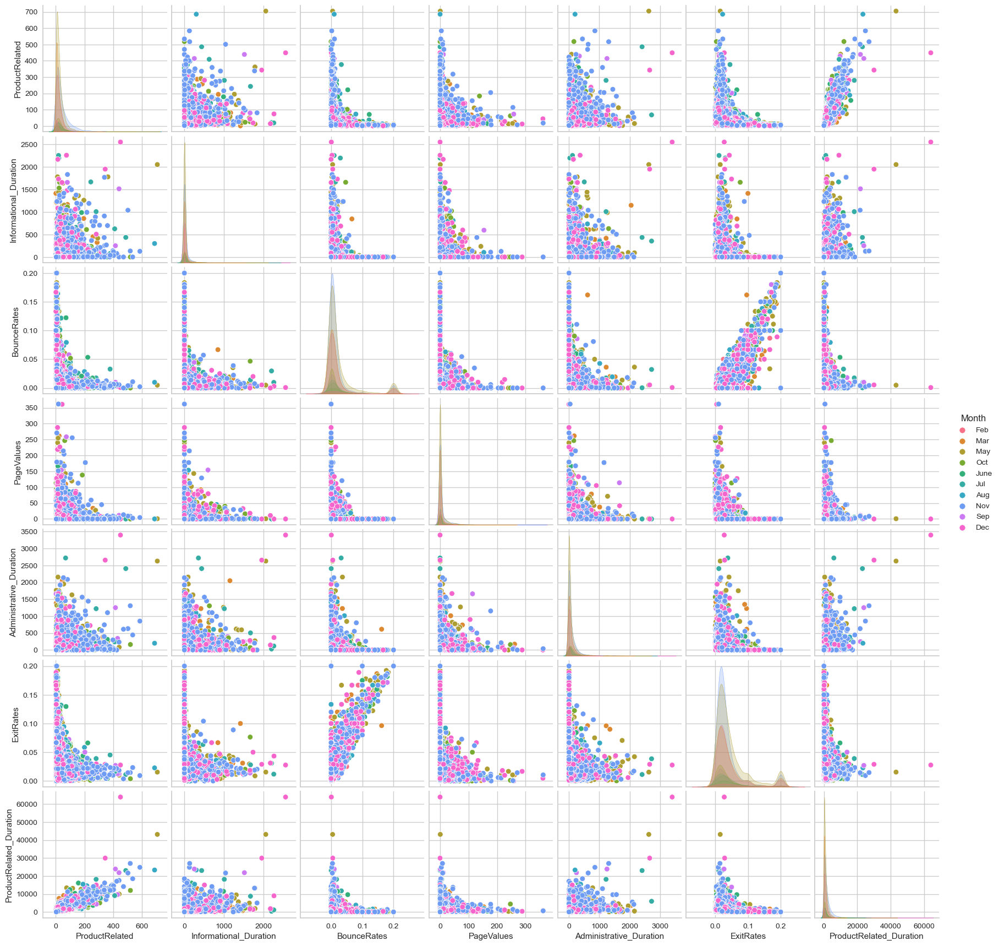

In [602]:
sns.pairplot(data=df,x_vars=cluster_features,y_vars=cluster_features,hue='Month')
plt.show()

## `K-Means clustering`

In [24]:
df_cluster = df[cluster_features].apply(zscore)
df_95_std = df_95.apply(zscore)

In [25]:
clusters = range(1,8)
wcss = []
for k in clusters:
    k_means = KMeans(n_clusters=k,random_state=93)
    k_means.fit(df_95_std)
    wcss.append(k_means.inertia_)

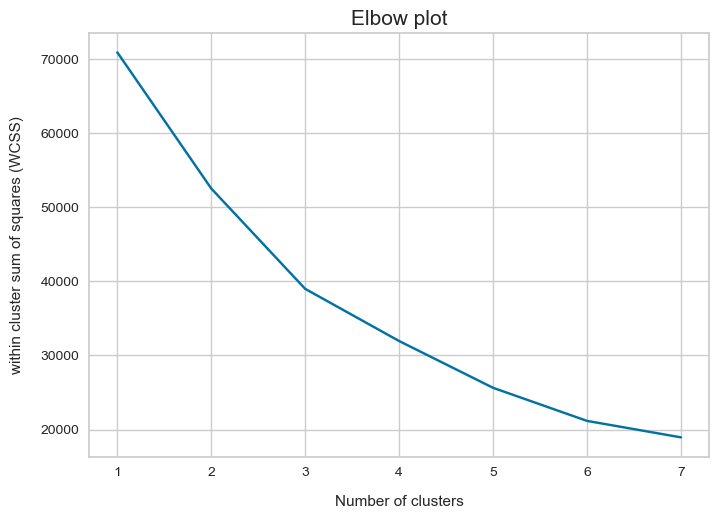

In [26]:
sns.lineplot(x=clusters,y=wcss,markers=True)
plt.title("Elbow plot",fontsize=15)
plt.xticks(range(1,8),range(1,8))
plt.xlabel("Number of clusters",fontsize=11,labelpad=12)
plt.ylabel("within cluster sum of squares (WCSS)",fontsize=11,labelpad=12)
plt.show()

In [27]:
clusters = range(2,8)
s_score = []
for k in clusters:
    k_means = KMeans(n_clusters=k,random_state=93)
    k_means.fit(df_95_std)
    labels = k_means.labels_
    s_score.append(silhouette_score(df_95_std,labels))

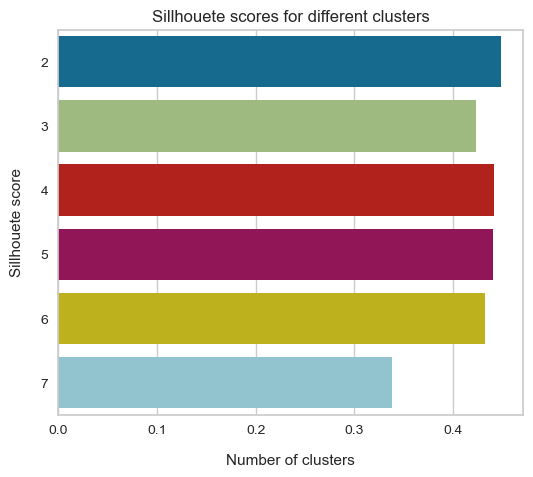

In [28]:
fig, ax = plt.subplots(figsize=(6,5))
ax = sns.barplot(y=list(clusters),x=s_score,orient='h')
plt.title("Sillhouete scores for different clusters",fontsize=12)
plt.xlabel("Number of clusters",fontsize=11,labelpad=12)
plt.ylabel("Sillhouete score",fontsize=11,labelpad=12)
plt.show()

In [427]:
# from the above plot we are getting optimal number of clusters as 2 
# for n_clusters = 2, sillhouete score is maximum 

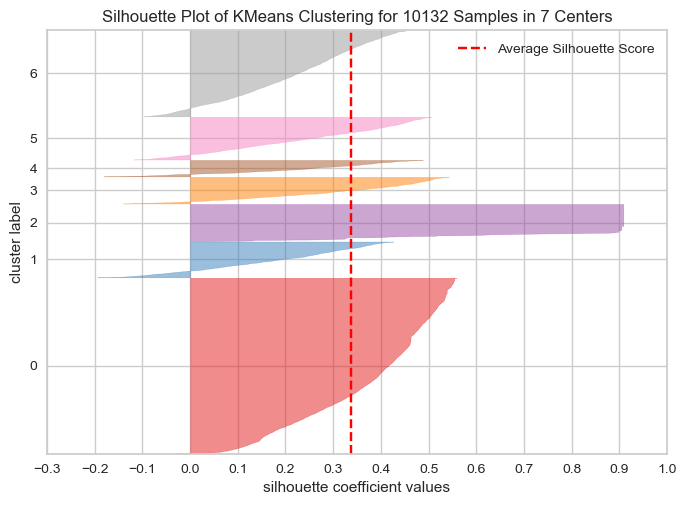

In [28]:
silhouette_visualizer(k_means,df_95_std)
plt.show()

In [29]:
final_cluster = KMeans(n_clusters=2,random_state=93)
final_cluster.fit(df_95)

KMeans(n_clusters=2, random_state=93)

In [30]:
df_95['cluster'] = final_cluster.labels_
df_cluster_data['cluster'] = final_cluster.labels_

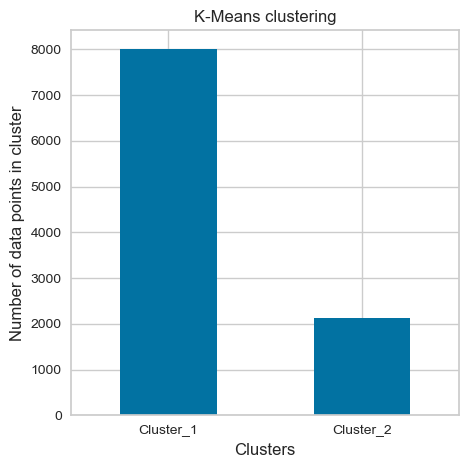

In [31]:
df_cluster_data['cluster'].value_counts().plot(kind='bar',rot=0,figsize=(5,5))
plt.xticks([0,1],['Cluster_1','Cluster_2'])
plt.xlabel("Clusters",fontsize=12)
plt.ylabel("Number of data points in cluster",fontsize=12)
plt.title("K-Means clustering",fontsize=12)
plt.show()

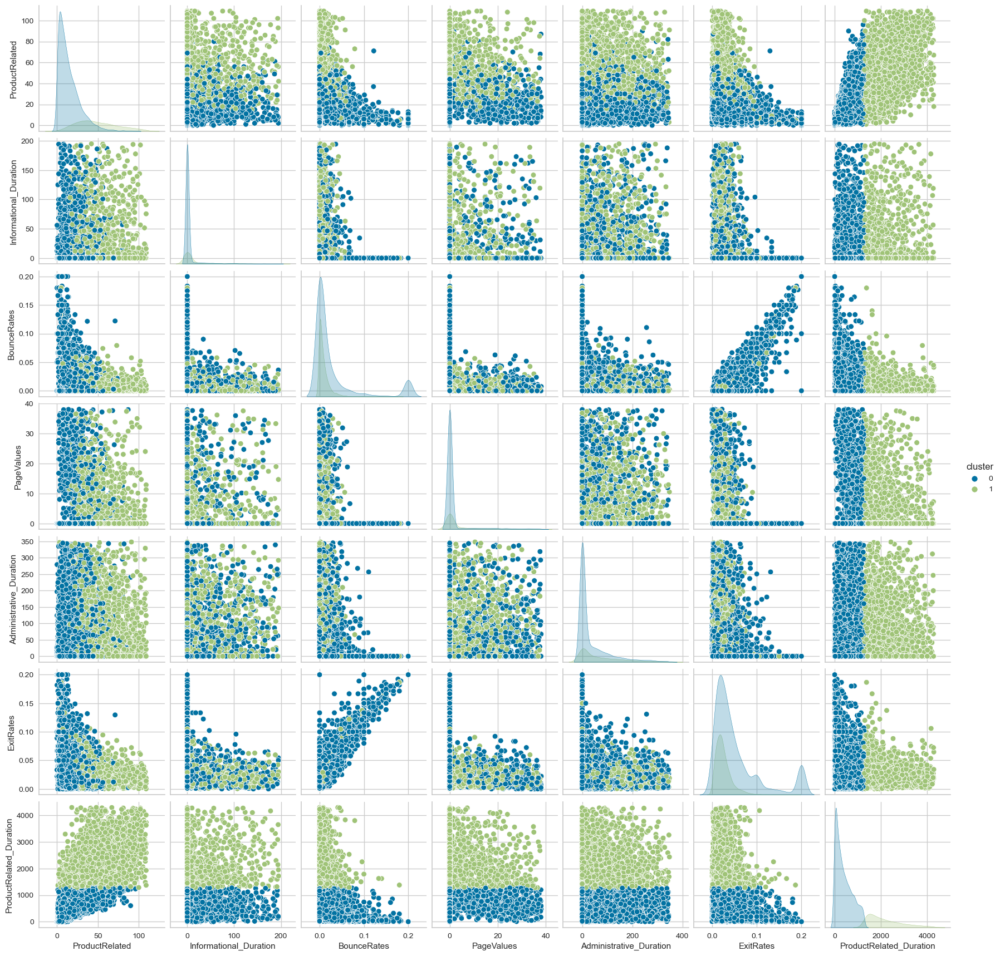

In [615]:
sns.pairplot(data=df_95,hue='cluster')
plt.show()

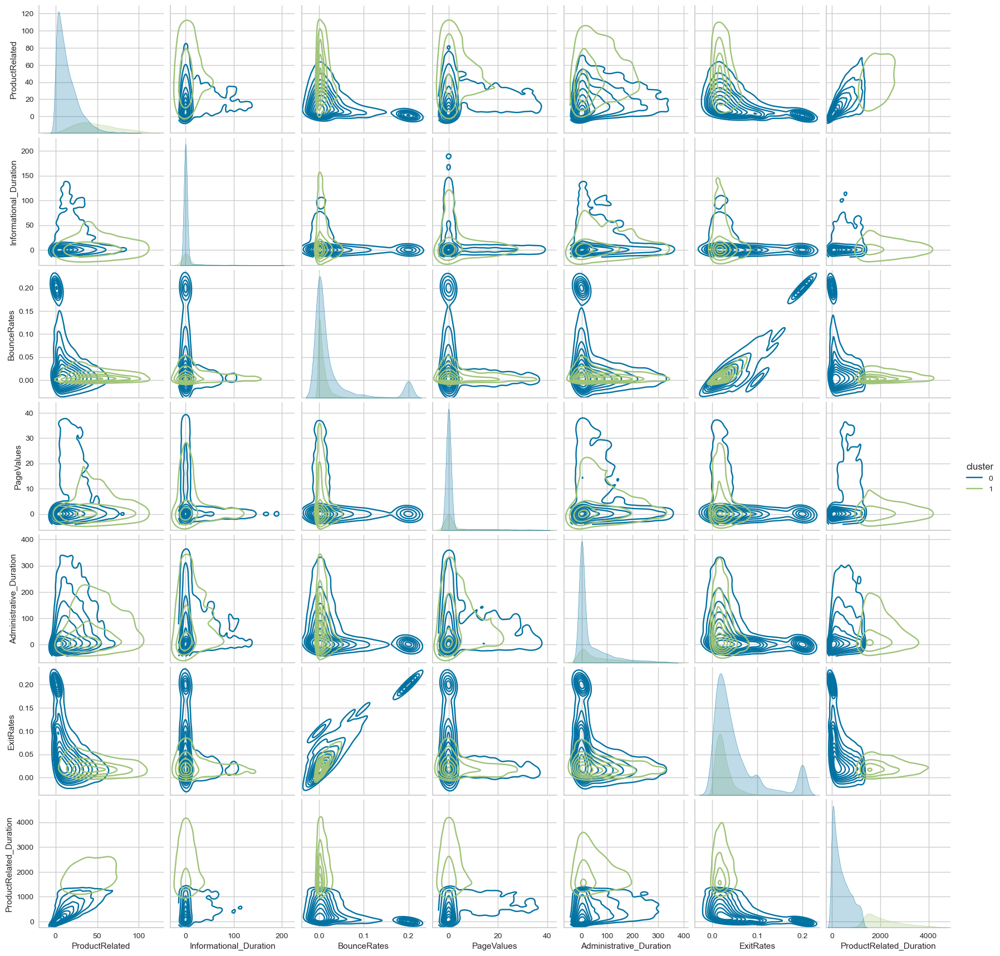

In [202]:
sns.pairplot(data=df_95,kind='kde',hue='cluster')
plt.show()

## `Principal component analysis`

In [85]:
pca = PCA(n_components=7)
df_pca = pd.DataFrame(data=pca.fit_transform(df_95_std),columns=pca.get_feature_names_out())

In [86]:
df_pca.head()

,pca0,pca1,pca2,pca3,pca4,pca5,pca6
0,-4.038153,2.303842,0.055236,-0.197857,-0.382556,-0.049747,-0.228613
1,-1.355347,-0.701131,0.092261,0.096943,0.288836,0.146742,0.936954
2,-4.038153,2.303842,0.055236,-0.197857,-0.382556,-0.049747,-0.228613
3,-2.186457,0.168966,0.094372,0.015871,0.098646,0.066508,0.858404
4,-0.590067,-0.544668,-0.304957,0.026988,0.291599,0.269992,0.004880


In [87]:
pca_cluster = KMeans(n_clusters=2)
pca_cluster.fit(df_pca)

KMeans(n_clusters=2)

In [88]:
df_cluster_data['pca_cluster'] = pca_cluster.labels_
df_95['pca_cluster'] = pca_cluster.labels_

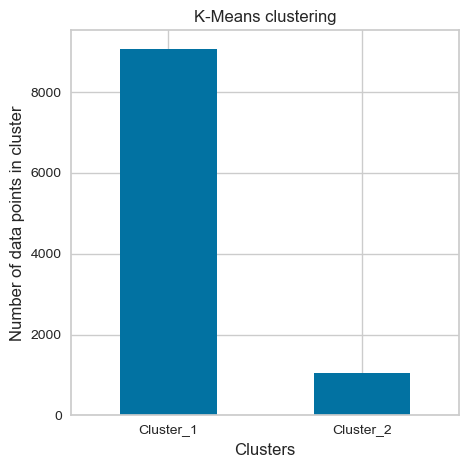

In [89]:
df_cluster_data['pca_cluster'].value_counts().plot(kind='bar',rot=0,figsize=(5,5))
plt.xticks([0,1],['Cluster_1','Cluster_2'])
plt.xlabel("Clusters",fontsize=12)
plt.ylabel("Number of data points in cluster",fontsize=12)
plt.title("K-Means clustering",fontsize=12)
plt.show()

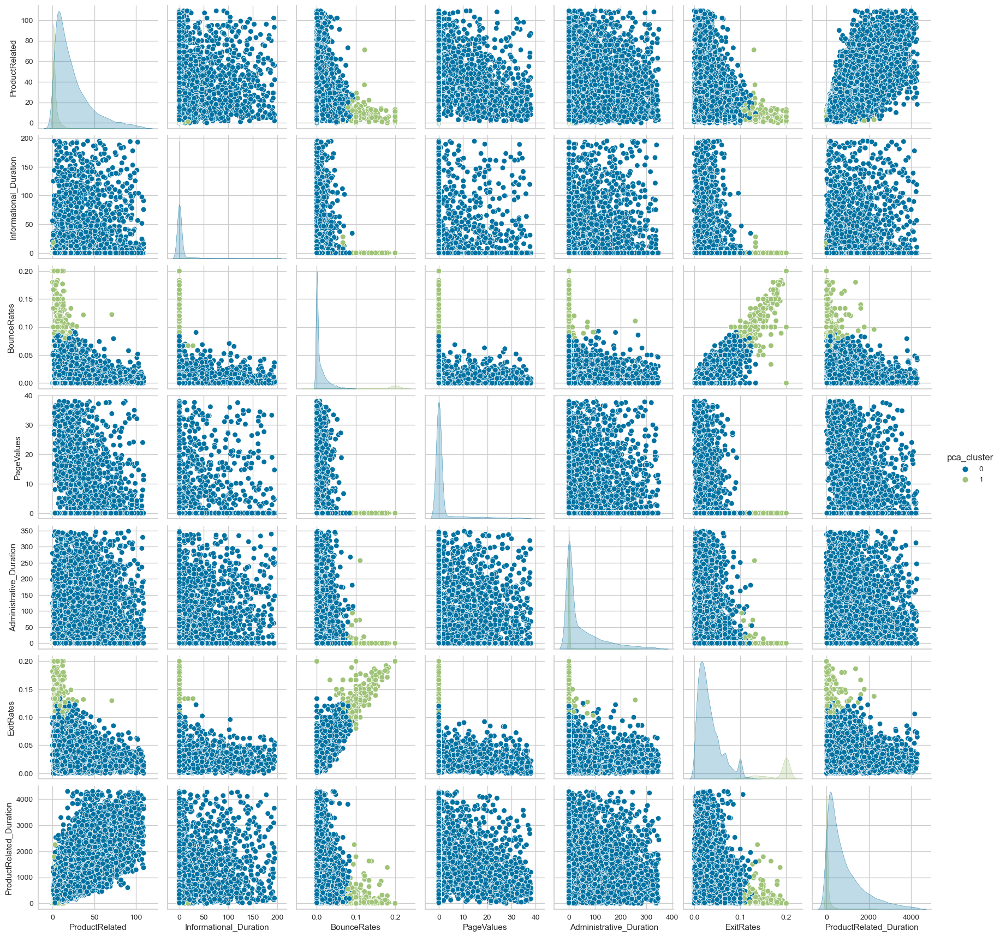

In [83]:
sns.pairplot(data=df_95.drop(columns=['cluster']),hue='pca_cluster')
plt.show()

In [90]:
# PCA did not yield significant number of cluster data points even after
# extraxting same components as original dataset

In [31]:
df_cluster_0 = df_cluster_data[df_cluster_data['cluster'] == 0]
df_cluster_1 = df_cluster_data[df_cluster_data['cluster'] == 1]

In [32]:
df_95['cluster'].value_counts()

0    8014
1    2118
Name: cluster, dtype: int64

In [33]:
df_cluster_0[cluster_features].describe()

,ProductRelated,Informational_Duration,BounceRates,PageValues,Administrative_Duration,ExitRates,ProductRelated_Duration
count,8014.000000,8014.000000,8014.000000,8014.000000,8014.000000,8014.000000,8014.000000
mean,14.527702,5.035667,0.030088,1.715413,36.593959,0.054218,398.221565
std,13.081002,21.421576,0.058025,6.122875,66.422973,0.055911,354.934434
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,5.000000,0.000000,0.000000,0.000000,0.000000,0.016667,93.750000
50%,11.000000,0.000000,0.000000,0.000000,0.000000,0.033333,298.200000
75%,21.000000,0.000000,0.026316,0.000000,49.000000,0.066667,644.000000
max,96.000000,194.400000,0.200000,38.123686,345.000000,0.200000,1275.900000


In [34]:
df_cluster_1[cluster_features].describe()

,ProductRelated,Informational_Duration,BounceRates,PageValues,Administrative_Duration,ExitRates,ProductRelated_Duration
count,2118.000000,2118.000000,2118.000000,2118.000000,2118.000000,2118.000000,2118.000000
mean,48.819641,16.270955,0.009046,3.789071,68.885687,0.025340,2152.395701
std,24.475539,37.600251,0.013120,7.688312,82.995119,0.018833,733.881947
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000262,1273.875000
25%,30.000000,0.000000,0.000000,0.000000,0.000000,0.012947,1558.796786
50%,45.000000,0.000000,0.004878,0.000000,37.000000,0.021199,1955.476009
75%,65.000000,7.000000,0.012245,3.899261,113.687500,0.032248,2588.135388
max,109.000000,195.000000,0.180000,37.596468,347.791667,0.186667,4293.833333


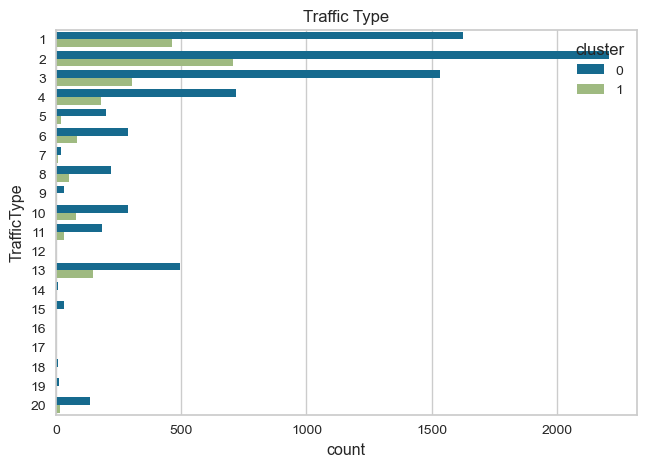

In [151]:
fig, ax = plt.subplots(figsize=(7.5,5))
sns.countplot(y=df_cluster_data['TrafficType'],hue=df_cluster_data['cluster'],ax=ax)
ax.set_xlabel(ax.get_xlabel(),fontsize=11.5)
ax.set_ylabel(ax.get_ylabel(),fontsize=11.5)
ax.set_title("Traffic Type")
plt.show()

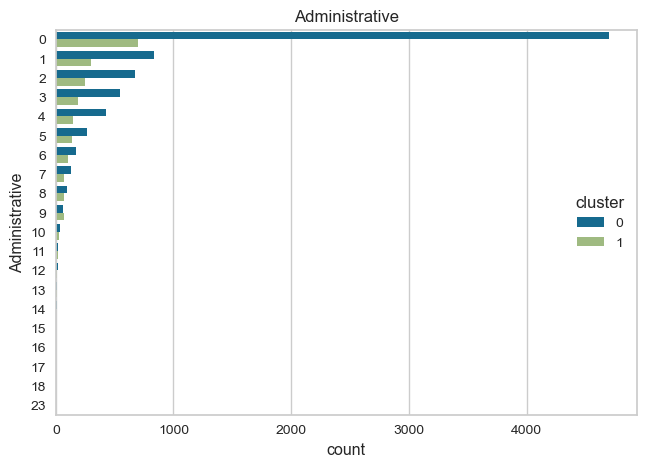

In [156]:
fig, ax = plt.subplots(figsize=(7.5,5))
sns.countplot(y=df_cluster_data[visualize_3[0]],hue=df_cluster_data['cluster'],ax=ax)
ax.set_xlabel(ax.get_xlabel(),fontsize=11.5)
ax.set_ylabel(ax.get_ylabel(),fontsize=11.5)
ax.set_title("Administrative")
plt.show()

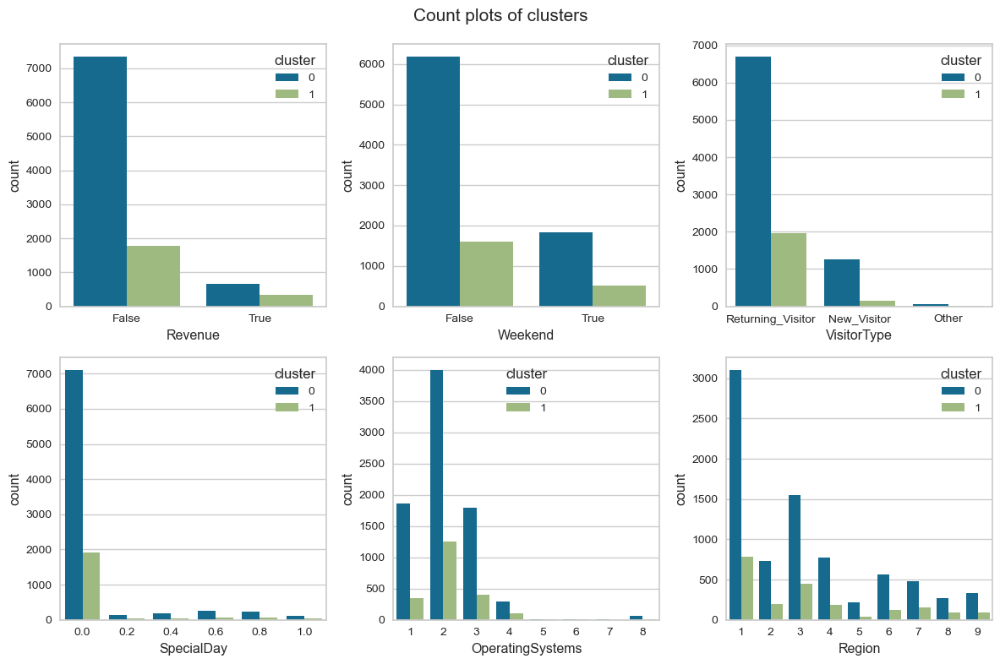

In [150]:
fig, ax = plt.subplots(2,3,figsize=(12,8))
fig.suptitle("Count plots of clusters",fontsize=15)
for feature,subplot in zip(visualize_1,ax.flatten()):
    sns.countplot(df_cluster_data[feature],hue=df_cluster_data['cluster'],ax=subplot)
    subplot.set_xlabel(subplot.get_xlabel(),fontsize=11.5)
    subplot.set_ylabel(subplot.get_ylabel(),fontsize=11.5)
plt.tight_layout()
plt.show()

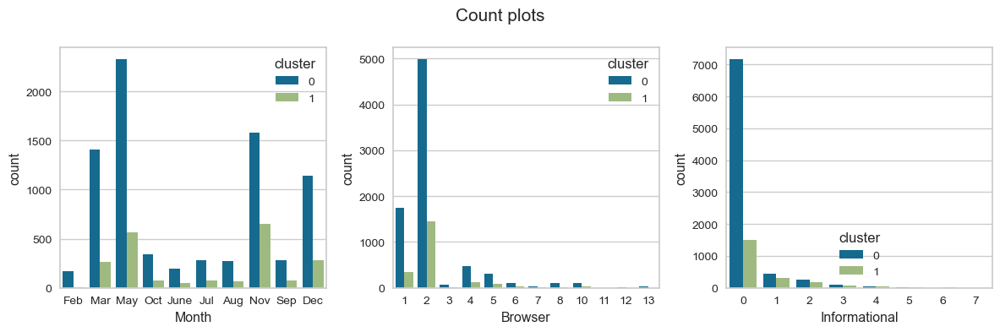

In [161]:
fig, ax = plt.subplots(1,3,figsize=(12,4))
fig.suptitle("Count plots",fontsize=15)
for feature,subplot in zip(visualize_2,ax.flatten()):
    sns.countplot(df_cluster_data[feature],hue=df_cluster_data['cluster'],ax=subplot)
    subplot.set_xlabel(subplot.get_xlabel(),fontsize=11.5)
    subplot.set_ylabel(subplot.get_ylabel(),fontsize=11.5)
plt.tight_layout()
plt.show()

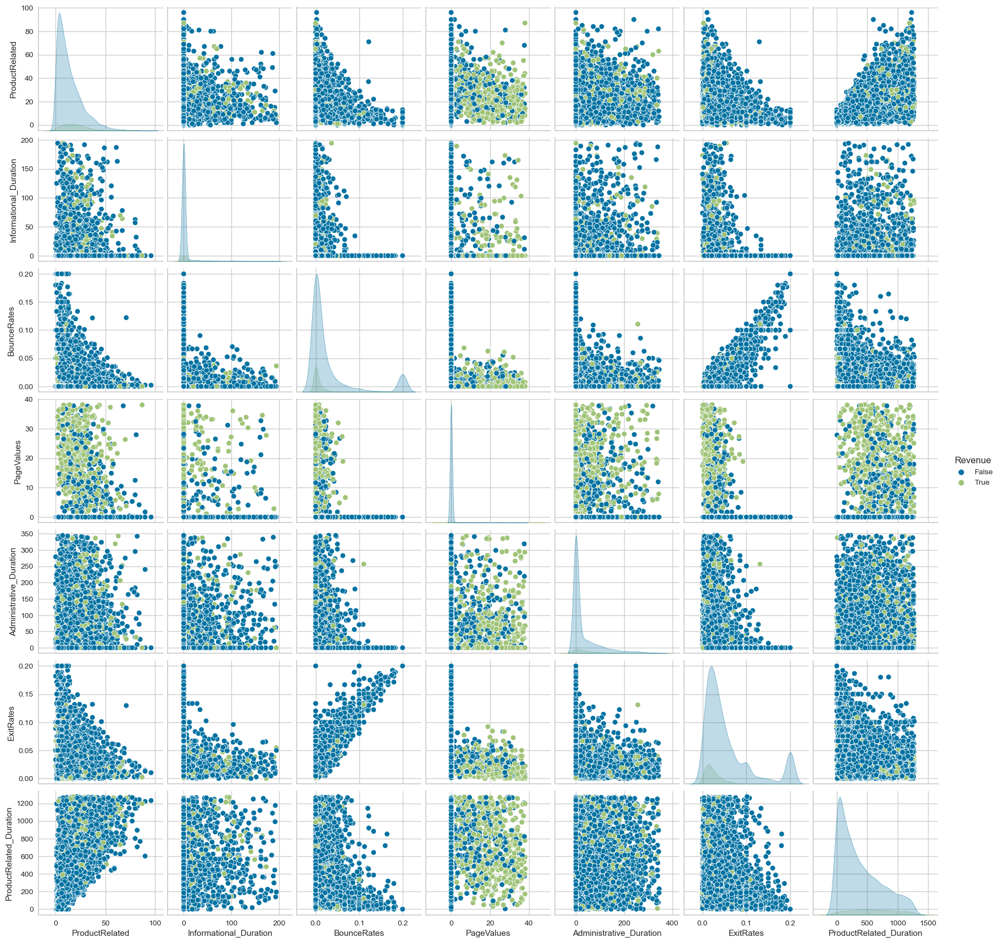

In [624]:
sns.pairplot(data=df_cluster_0,x_vars=cluster_features,y_vars=cluster_features,hue='Revenue')
plt.show()

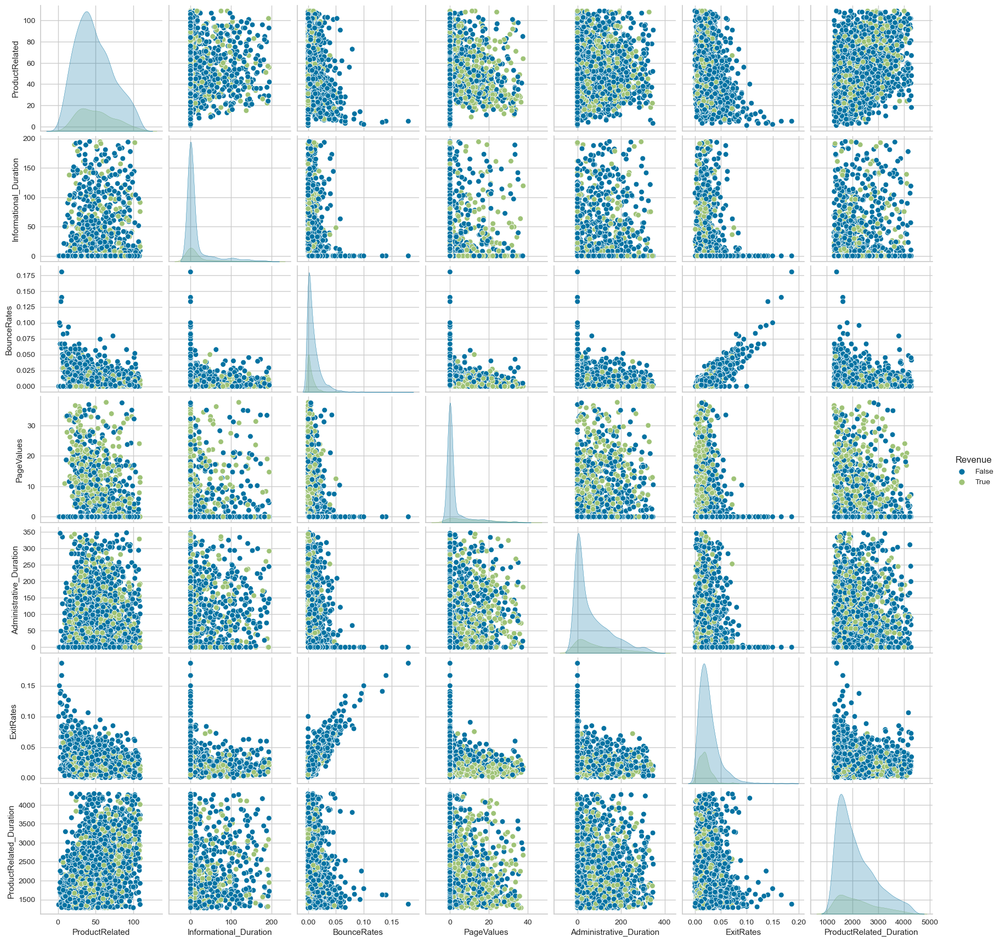

In [625]:
sns.pairplot(data=df_cluster_1,x_vars=cluster_features,y_vars=cluster_features,hue='Revenue')
plt.show()

<Figure size 1500x500 with 0 Axes>

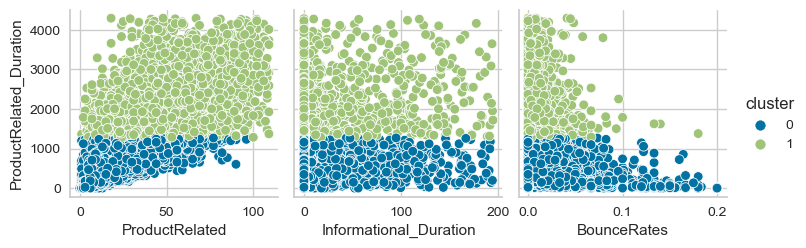

In [65]:
plt.figure(figsize=(15,5))
sns.pairplot(data=df_cluster_data,x_vars=cluster_features[:-4],y_vars='ProductRelated_Duration',
             hue='cluster',)
plt.show()

<Figure size 1500x500 with 0 Axes>

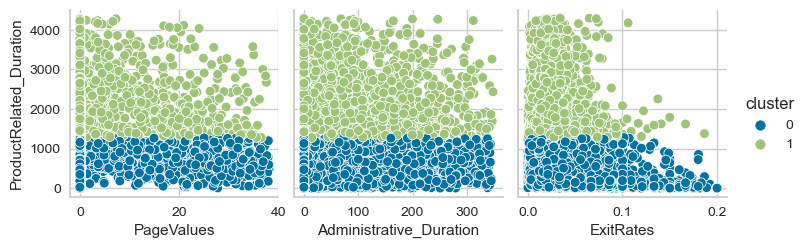

In [67]:
plt.figure(figsize=(15,5))
sns.pairplot(data=df_cluster_data,x_vars=cluster_features[-4:-1],y_vars='ProductRelated_Duration',
             hue='cluster',)
plt.show()

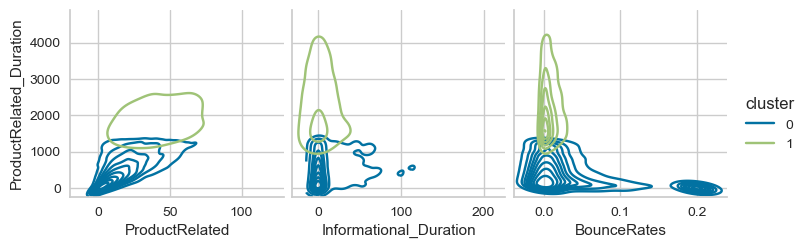

In [66]:
sns.pairplot(data=df_cluster_data,x_vars=cluster_features[:-4],y_vars='ProductRelated_Duration',
             hue='cluster',kind='kde',)
plt.show()

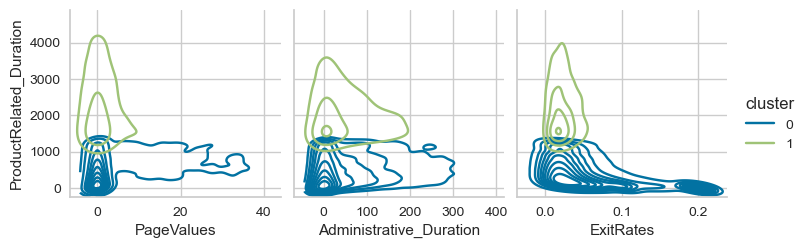

In [68]:
sns.pairplot(data=df_cluster_data,x_vars=cluster_features[-4:-1],y_vars='ProductRelated_Duration',
             hue='cluster',kind='kde',)
plt.show()

<Figure size 1500x500 with 0 Axes>

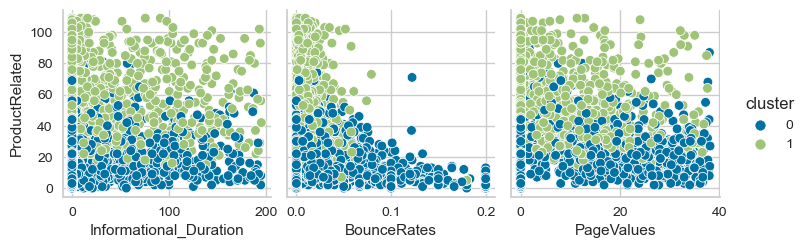

In [69]:
plt.figure(figsize=(15,5))
sns.pairplot(data=df_cluster_data,x_vars=cluster_features[1:4],y_vars='ProductRelated',
             hue='cluster',)
plt.show()

<Figure size 1500x500 with 0 Axes>

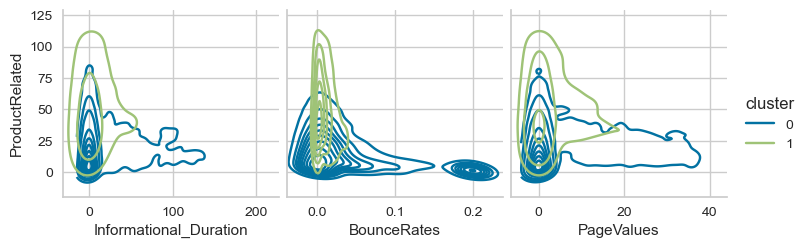

In [70]:
plt.figure(figsize=(15,5))
sns.pairplot(data=df_cluster_data,x_vars=cluster_features[1:4],y_vars='ProductRelated',
             hue='cluster',kind='kde')
plt.show()

<Figure size 1500x500 with 0 Axes>

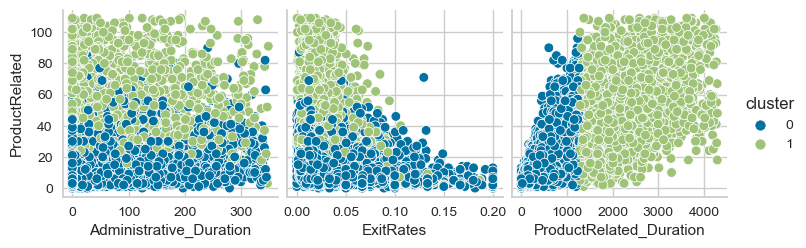

In [71]:
plt.figure(figsize=(15,5))
sns.pairplot(data=df_cluster_data,x_vars=cluster_features[4:],y_vars='ProductRelated',
             hue='cluster',)
plt.show()

<Figure size 1500x500 with 0 Axes>

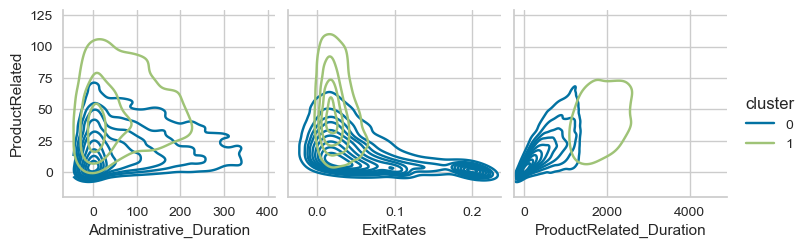

In [72]:
plt.figure(figsize=(15,5))
sns.pairplot(data=df_cluster_data,x_vars=cluster_features[4:],y_vars='ProductRelated',
             hue='cluster',kind='kde')
plt.show()

## `Agglomerative clustering (Hierarchical)`

In [37]:
# instantiate linkage object with scaled data and consider 'ward' linkage method 
link_mat = linkage(df_95_std, method = 'ward')     

# printing first 10 observations of the linkage matrix 'link_mat'
print(link_mat[0:10])

[[0.0000e+00 2.0000e+00 0.0000e+00 2.0000e+00]
 [6.0000e+00 1.0132e+04 0.0000e+00 3.0000e+00]
 [1.6000e+01 1.0133e+04 0.0000e+00 4.0000e+00]
 [7.0000e+00 2.0550e+03 0.0000e+00 2.0000e+00]
 [8.0000e+00 3.0110e+03 0.0000e+00 2.0000e+00]
 [2.4000e+01 1.0134e+04 0.0000e+00 5.0000e+00]
 [1.8000e+01 1.4640e+03 0.0000e+00 2.0000e+00]
 [2.1000e+01 1.8200e+02 0.0000e+00 2.0000e+00]
 [2.2000e+01 9.9790e+03 0.0000e+00 2.0000e+00]
 [2.3000e+01 1.7840e+03 0.0000e+00 2.0000e+00]]


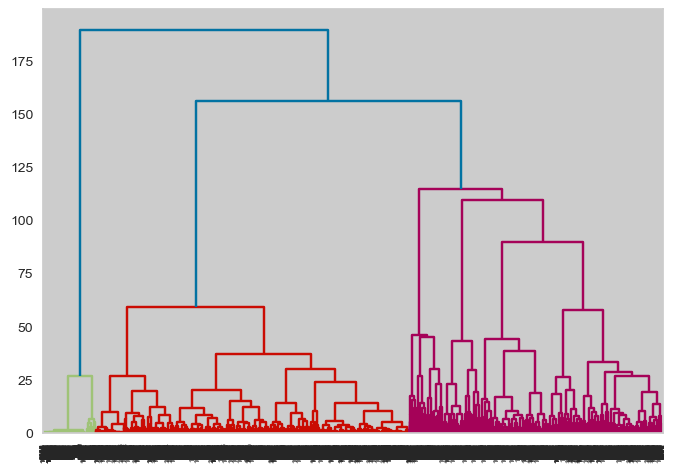

In [627]:
# write your code here

gram = dendrogram(link_mat)

plt.show()

In [38]:
df_95_std.shape

(10132, 7)

In [39]:
# calculating the euclidean distance between the observations 
eucli_dist = euclidean_distances(df_95_std)

# the above code will return the matrix of 10132 x 10132
# consider only the array of upper triangular matrix
# k=1 considers the upper triangular values without the diagonal elements
dist_array = eucli_dist[np.triu_indices(10132, k = 1)]

# passing the linkage matrix and actual distance
# 1st output of the cophenet() is the correlation coefficient
coeff, cophenet_dist = cophenet(link_mat, dist_array)

# print the cophenetic correlation coefficient
print(f"Cophenetic correlation coefficient : {coeff:0.4f}")

Cophenetic correlation coefficient : 0.6413


In [203]:
# agglomerative clustering recursively merges the pair of clusters that minimally increases a given linkage distance.
# instantiate clustering method with 2 clusters and 'ward' linkage method
# ‘ward’ method of linkage minimizes the variance of the clusters that are being merged

clusters = AgglomerativeClustering(n_clusters = 2, linkage = 'ward')

# fit the model on the scaled data
clusters.fit_predict(df_95_std)

array([1, 0, 1, ..., 0, 0, 0], dtype=int64)

In [204]:
df_95['hierarchy_cluster'] = clusters.labels_
df_cluster_data['hierarchy_cluster'] = clusters.labels_

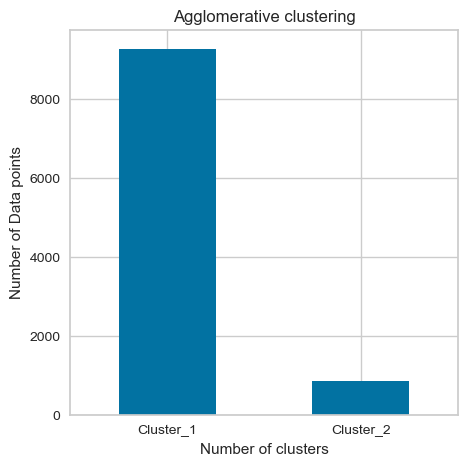

In [205]:
df_cluster_data['hierarchy_cluster'].value_counts().plot(kind='bar',rot=0,figsize=(5,5))
plt.title("Agglomerative clustering")
plt.xlabel("Number of clusters")
plt.ylabel("Number of Data points")
plt.xticks([0,1],['Cluster_1','Cluster_2'])
plt.show()

In [168]:
# very less number of clusters

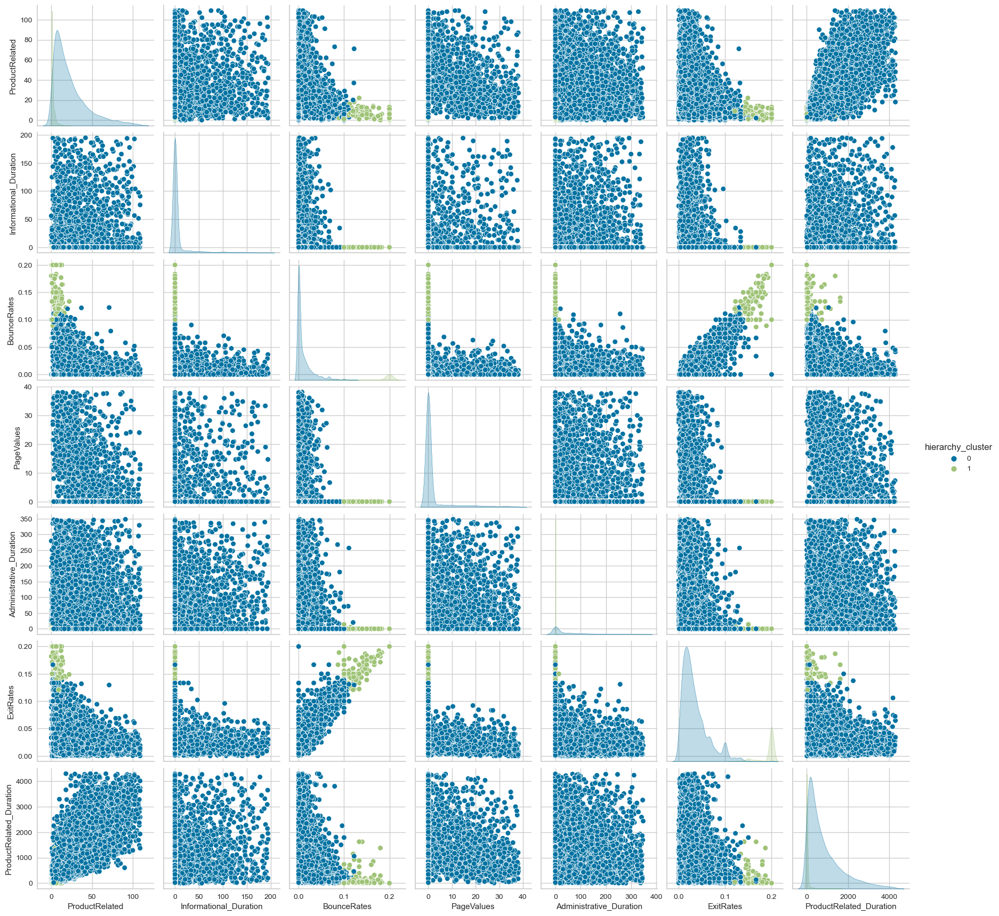

In [206]:
sns.pairplot(data=df_cluster_data,x_vars=cluster_features,y_vars=cluster_features,
             hue='hierarchy_cluster')
plt.show()

In [207]:
df_h_cluster_0 = df_cluster_data[df_cluster_data['hierarchy_cluster'] == 0]
df_h_cluster_1 = df_cluster_data[df_cluster_data['hierarchy_cluster'] == 1]

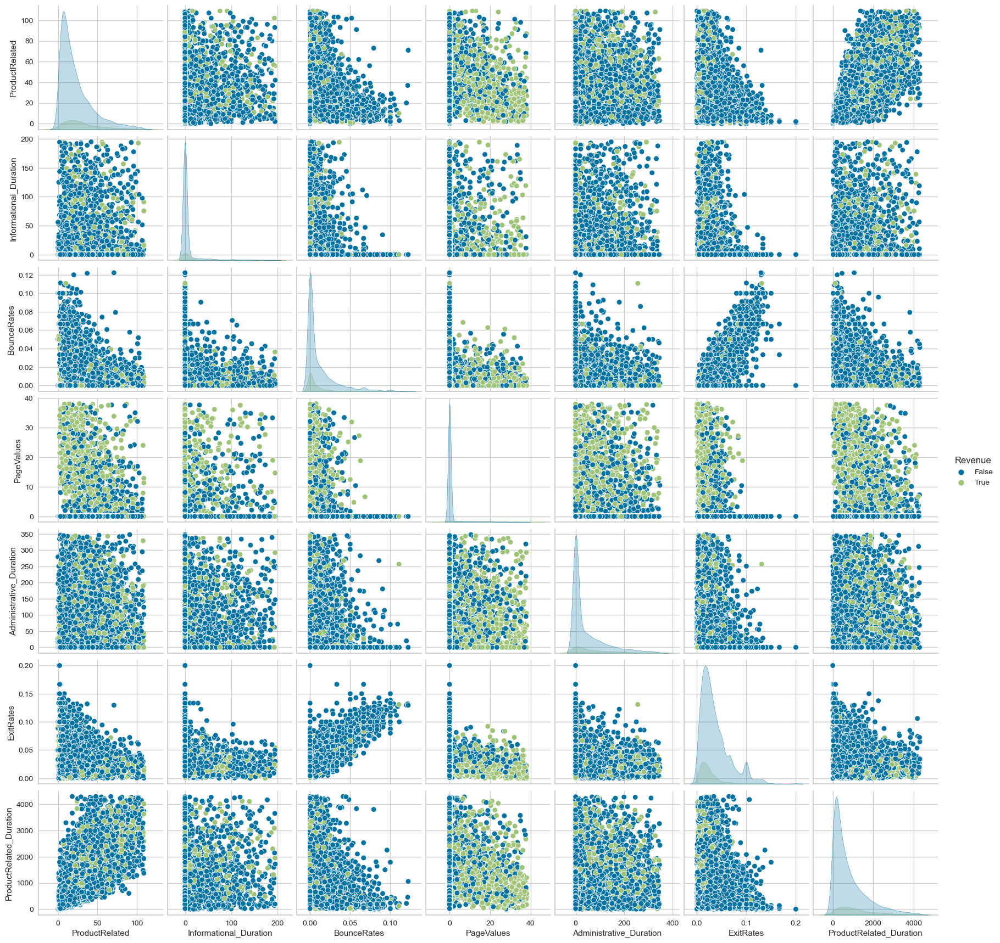

In [208]:
sns.pairplot(data=df_h_cluster_0,x_vars=cluster_features,y_vars=cluster_features,hue='Revenue')
plt.show()